In [3]:
!pip install plotly
!pip install modopt


#                       Blog: Deriving and experimenting with a (new) non-convex penalty based on the $k$-support norm

<strong style=color:red> **Disclaimer:** This blog just proposes some initial idea, forgive the imperfect writing and typos, and feel free to let me know if you see any mistake!
</strong>

# Description of the problem and introduction of the non-convex penalty based on the $k$-support norm

We will consider the following optimization problem: 

$$ \min_{x \in \mathbb{R}^d} f(x) + \lambda h(x), $$

where $f$ is a smooth function, and $h$ is a penalty term which goal is to ensure sparsity of the solution $x$, and $\lambda \geq 0$ is the penalty strength. We will consider the following (new up to our knowledge) non-convex penalty term: 

$$h(x) := g(x) - \frac{1}{2} \|x \|^2,$$

where $g(\cdot) := \frac{1}{2}\left(\| \cdot \|^{sp}_{k}\right)^2 $ denotes the half-squared $k$-support norm defined in [1]. We will optimize this problem with (non-convex) proximal gradient descent [2].



# Motivation

Such penalty is $0$ for (at most) $k$ sparse vectors, and non-zero for vectors with more than $k$ non-zero elements (the reason why will become clearer from the proofs below). Indeed, as will be shown below, for any $x \in \mathbb{R}^d$, we have: $\| x \|^{sp}_{k} \geq \| x\|_2$, and we have equality if $x$ is (at most) $k$-sparse. As such, when $\lambda \rightarrow \infty$, the penalty converges to the indicator of the $\ell_0$ pseudo-ball of radius $k$. It is (to our knowledge) the first and only non-convex penalty which explicitly allows to specify a precise sparsity $k$ (except the $\ell_0$ penalty itself) (in comparison, other non-convex penalties such as SCAD, MCP, or $\ell_p$ norms, will penalize any non-zero vector, even if its sparsity lower or equal than $k$).

# Closed form for the proximal operator

We recall the definition of the proximal operator, for some function $h: \mathbb{R}^d \rightarrow \mathbb{R}$, and for all $z \in \mathbb{R}^d$: 

$$\text{prox}_{h}(z) \in \arg\min_{x} h(x) + \frac{1}{2} \| x - z\|^2 $$





Below we give the closed form for the proximal operator of $\lambda h$, which shows that it can be obtained efficiently from the proximal operator of the half-squared $k$-support norm (which is known, cf. [1]
or [4]).

<!-- \begin{lemma}\label{lem:proximal_closed_form} -->

**Lemma 1.** (Closed form for the proximal operator)
    
$$\text{prox}_{\lambda h} (z) = \begin{cases}
    \text{prox}_{\frac{\lambda}{1 - \lambda} g}(\frac{1}{1 - \lambda}z) ~\text{if}~ \lambda < 1\\
    \mathcal{H}_k(z) ~\text{if}~ \lambda \geq 1
\end{cases}, $$

where $ \mathcal{H}_k$ denotes the hard-thresholding operator, which keeps the $k$ largest components (in absolute value), and sets the remaining one to 0 (if there are ties, we can break them for instance lexicographically).


**Proof.**

**Case 1: $\lambda < 1$**

We have: 

\begin{align*}
    \text{prox}_{\lambda h} (z) &= \arg\min_{x} \lambda \left(\frac{1}{2} \left(\|x \|^{sp}_{k}\right)^2 - \frac{1}{2} \|x \|^2 \right) + \frac{1}{2} \| x - z\|^2\\
    &= \arg\min_{x} \frac{\lambda}{2} \left(\|x \|^{sp}_{k}\right)^2 + \frac{1-\lambda}{2} \|x \|^2  -  \langle x, z \rangle\\
        &= \arg\min_{x} \frac{\lambda}{2(1-\lambda)} \left(\|x \|^{sp}_{k}\right)^2  +\frac{1}{2} \|x \|^2  -  \langle x, \frac{1}{1-\lambda} z \rangle\\
        &= \arg\min_{x} \frac{\lambda}{2(1-\lambda)} \left(\|x \|^{sp}_{k}\right)^2  +\frac{1}{2} \|x - \frac{1}{1 - \lambda} z \|^2\\
        &= \text{prox}_{\frac{\lambda}{1- \lambda} g} (\frac{1}{1 - \lambda} z)
\end{align*}

Where we used the fact that changing the optimization problem by an additive constant and/or a strictly positive multiplicative constant does not change the $\arg\min$.

**Case 2: $\lambda \geq 1$**


[1] introduce the $k$-support norm as the norm which unit ball is the tightest convex relaxation of the $\ell_0$-pseudo-ball (of radius $k$) and the $\ell_2$ unit ball, that is, the $k$-support support norm is the gauge function associated to the following set: $\mathcal{C}_k = \text{conv}\{x \in \mathbb{R}^d: \| x\|_0 \leq k \text{ and } \| x\|_2\leq 1\}$, that is for a vector $x \in \mathbb{R}^d$: $\| x \|_{k}^{sp} = \inf \{ \lambda \in \mathbb{R}_{+} \text{ s.t. }  x \in \lambda \mathcal{C}_k\}$ (as per  footnote 4 in [1]).  Let us now consider some $(v, w) \in (\mathbb{R}^d)^2$. 
According to the above, there exist, for some $N \in \mathbb{N}$, some $\{y_i\}_{i=1}^N$ s.t. $w = \lambda \sum_{i=1}^N \nu_i y_i $ with $\lambda \leq \| w\|_{k}^{sp}$ and for all $i$ in $[N]$, $\| y_i\|_2 \leq 1$, $\|y_i \|_0 \leq k$, $\nu_i \in [0, 1]$, and $\sum_{i=1}^N \nu_i = 1$. Since the $k$-support norm is a norm (and therefore verifies the homogeneity property $\lambda \|\cdot \|_{k}^{sp} = \|\lambda \cdot \|_{k}^{sp}$), this implies (by defining $x_i := \lambda y_i$ for all $i \in [N]$ ) that there exist  some $\{x_i\}_{i=1}^N$ s.t. $w = \sum_{i=1}^N \nu_i x_i $ and for all $i$ in $[N]$,  $\|x_i \|_0 \leq k$, $\| x_i\| \leq \| x \|_{k}^{sp}$, $\nu_i \in [0, 1]$, and $\sum_{i=1}^N \nu_i = 1$.
Let us now consider the following function: 

\begin{align}
h_{v}(w)&:=\lambda \left(\frac{1}{2} \left(\|w\|_k^{s p}\right)^2 - \frac{1}{2} \|w\|^2 \right) + \frac{1}{2} \|w - v \|^2 \nonumber\\
    &=\frac{\lambda}{2} \left(\|w\|_k^{s p}\right)^2 + \frac{1 - \lambda}{2} \| w \|^2 + \langle w, v \rangle + \frac{1}{2}\|v\|^2\nonumber\\
&\overset{(a)}{\geq} \frac{\lambda}{2} \left(\|w\|_k^{s p}\right)^2 +  \frac{1 - \lambda}{2} \left( \sum_{i=1}^N \nu_i \| x_i \|^2 \right)+ \langle w, v \rangle + \frac{1}{2}\|v\|^2\nonumber\\
&\overset{(b)}{\geq } \frac{\lambda}{2} \left(\sum_{i=1}^N\nu_i \|x_i\|^2\right) +  \frac{1 - \lambda}{2} \left( \sum_{i=1}^N \nu_i \| x_i \|^2 \right)+ \langle w, v \rangle + \frac{1}{2}\|v\|^2\nonumber\\
&= \frac{1}{2} \left(\sum_{i=1}^N\nu_i \|x_i\|^2\right) + \left(\sum_{i=1}^N \nu_i \langle x_i, v \rangle\right) + \sum_{i=1}^N  \frac{\nu_i}{2}\|v\|^2\nonumber\\
&= \frac{1}{2}\sum_{i=1}^N \nu_i\| x_i  - v \|^2 \geq \frac{1}{2}\min_{i \in [N]}\| x_i  - v \|^2 \overset{(c)}{\geq} \frac{1}{2}\min_{x \in \mathbb{R}^d \text{ s.t. } \|x \|_0\leq k} \| x  - v \|^2&\overset{(d)}{=} \frac{1}{2} \|\mathcal{H}_k(v) - v \|^2 \tag{1}
\end{align}

where (a) follows from the Jensen inequality and the fact that $1 - \lambda \leq 0 $, (b) from the fact that for all $i \in [N]$, $\| x_i \| \leq \| w \|_{k}^{sp}$ as mentioned above, (c) from the fact that $\| x_i \|_0 \leq k$ for all $i \in [N]$ as mentioned above, and (e) from the fact that projecting a vector $v$ onto the $\ell_0$ pseudo-ball of radius $k$ amounts to taking the hard-thresholding operator of $v$, i.e. preserving the top-$k$ (in magnitude) components of $v$, and setting the others to 0 (ties can be broken lexicographically) (this can be easily seen by observing that the minimization problem for the projection is separable and can be done coordinate-wise).

Therefore, from (1) above, we have that: 
\begin{equation} \tag{2}
    \forall w \in \mathbb{R}^d: h_{v}(w) \geq \frac{1}{2} \| \mathcal{H}_k(v) - v\|^2
\end{equation}

Additionally, for any $x \in \mathbb{R}^d$ such that $\|x \|_0 \leq k$, we have that $\| x\|_{k}^{sp} = \| x\|$ (see [1] for more details, this can be seen for instance from Proposition 2.1 in [1]), which implies that: 
\begin{equation} \tag{3}
 h_v(\mathcal{H}_k(v)) = \lambda \times 0 + \frac{1}{2} \| \mathcal{H}_k(v) - v \|^2 = \frac{1}{2} \| \mathcal{H}_k(v) - v \|^2.    
\end{equation} Therefore, from (2), we have that for any $v \in \mathbb{R}^d$, $\frac{1}{2} \| \mathcal{H}_k(v) - v \|^2$ is a lower bound on $h_v(w)$ when $w$ spans $\mathbb{R}^d$, and from (3) we have that this lower bound is attained for $w = \mathcal{H}_k(v)$, therefore, that lower bound is a minimum of $h_v(w)$ when $w$ spans $\mathbb{R}^d$, which implies that:

$$\mathcal{H}_k(v) \in \arg\min_{x \in \mathbb{R}^d} h_v(w) = \text{prox}_{\lambda h}(v)$$


$\square$

# Visualizing the penalty and its proximal operator

Below we provide a few visualizations for the penalty and the proximal operator of $\lambda h$, for various values of $\lambda$, when $d=2$ and $k=1$. As we can see, the larger the $\lambda$, the more the penalty resembles the $\ell_0$ constraint.


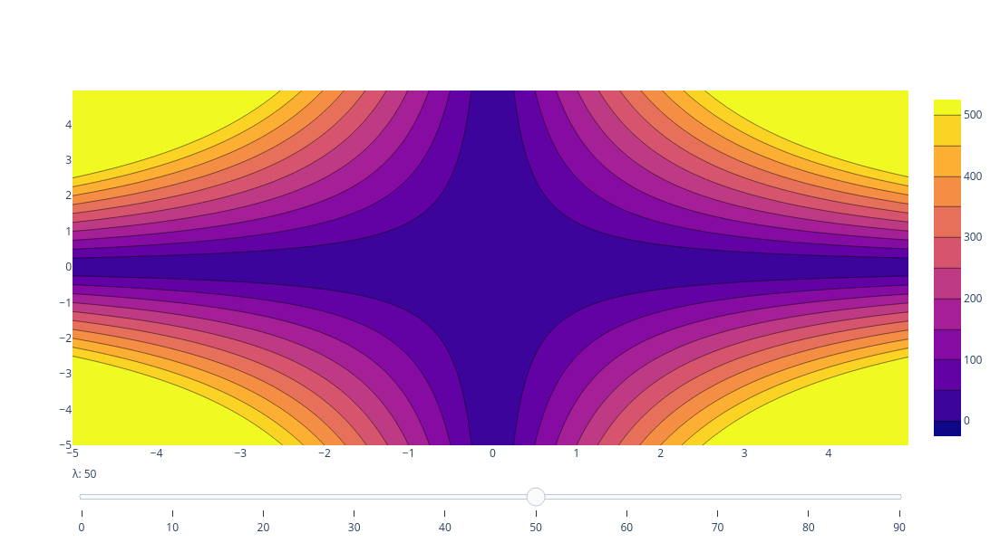

In [4]:
import plotly.graph_objects as go
import numpy as np

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, 100, 10):
    x = np.arange(-5, 5, 0.05)
    y = np.arange(-5, 5, 0.05)
    z = step * 1/2 * ( (np.abs(x[None]) + np.abs(y[:, None]))**2 - (x[None]**2 + y[:, None]**2))
    fig.add_trace(
    go.Contour(
        visible=False,
        z=z,
        x=x, # horizontal axis
        y=y, # vertical axis,
        contours=dict(
            start=0,
            end=500
        ),

    ))

fig.data[4].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="restyle",
        args=["visible", [False] * len(fig.data)],
        label=str(10*i),
    )
    step["args"][1][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=5,
    currentvalue={"prefix": "λ: "},
    # pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders,
width=600,  # Set the width of the plot
    height=600  # Set the height of the plot to be equal to the width
)

fig.show()

# Visualizing the proximal operator

Below we visualize the proximal operator of $h$ which closed form was found above, for $d=10$ and $k=5$, for different values of $\lambda$ from $0$ to $1$. As we can see, for $\lambda=1$ we retrieve the hard-thresholding operator, and for smaller values of $\lambda$, we obtain some "relaxed" hard-thresholding. 


In [5]:
from modopt.opt.proximity import KSupportNorm
import matplotlib.pyplot as plt

In [6]:
def _hard_threshold(arr, k):
    top_k_indices = np.argpartition(np.abs(arr), -k)[-k:]
    thresholded_arr = np.zeros_like(arr)
    thresholded_arr[top_k_indices] = arr[top_k_indices]
    return thresholded_arr

def prox_ksn(x, coef, k):
        if coef < 1:
            ksn = KSupportNorm(coef/(1 - coef), k)
            return ksn.op(x/(1-coef))
        else:
            return _hard_threshold(x, k)


In [7]:
seed = 42
rs = np.random.RandomState(42)
w = rs.randn(10)

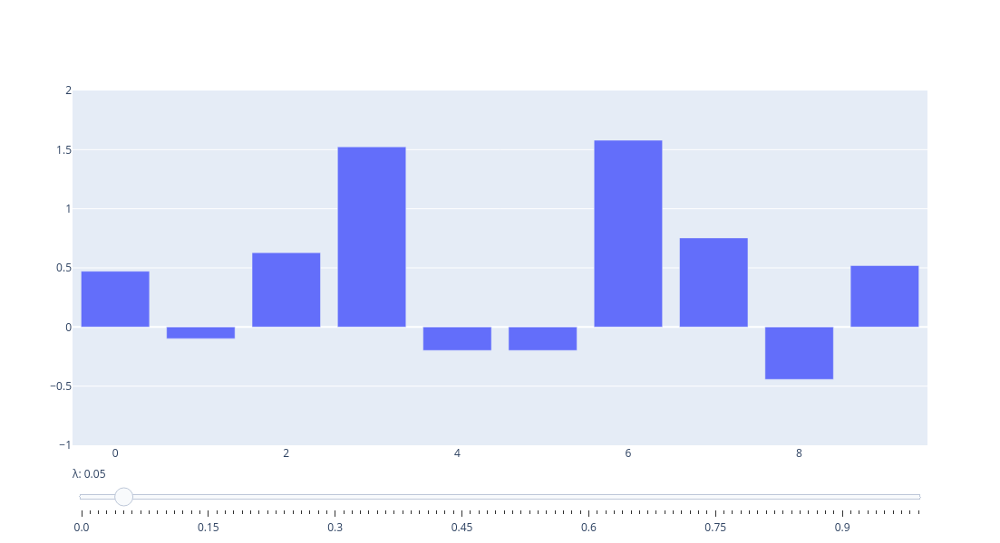

In [8]:
import plotly.graph_objects as go
import numpy as np

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, 1, 0.01):
    fig.add_trace(
        # go.Bar(visible=False, x  = np.arange(w.shape[0]), y = w, marker=dict(color='rgba(0,0,0,0)', line=dict(color='black', width=1))),
        go.Bar(visible=False, x  = np.arange(w.shape[0]), y = prox_ksn(w, step, 5))
    )

fig.data[4].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="restyle",
        args=["visible", [False] * len(fig.data)],
        label=str(0.01 * i),
    )
    step["args"][1][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=5,
    currentvalue={"prefix": "λ: "},
    # pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders,
width=600,  # Set the width of the plot
    height=600,  # Set the height of the plot to be equal to the width
    yaxis=dict(
        range=[-1, 2]  # Set the fixed range for the y-axis
    )
)

fig.show()

# Proximal Gradient descent with KSNN generalizes (and improves upon) IHT

Recall that one usual update rule of proximal gradient descent for minimizing a function $f + \lambda h$, where $f$ is $L$-smooth, is: 

$$x_{t+1} \leftarrow \text{prox}_{\eta \lambda h}(x_t - \eta \nabla f (x))$$

Such an algorithm rule is guaranteed to output an iterate which subdifferential is close enough to $\mathbf{0}$ for an appropriate choice of learning rate $\eta$, even in the case where $g$ is non-convex (see for instance Theorem 1 in [2], given for a uniformly random selection of the output iterate). Therefore, as we can see from above, if $\lambda \geq \frac{1}{\eta}$, such proximal algorithm will fall back to the Iterative Hard Thresholding algorithm (IHT). As such, we will study below the case where $\lambda < \frac{1}{\eta}$, where interesting things happen.


## Why it can improve upon IHT


We will consider a typical usage of non-convex penalties: say we have an optimization problem (linear regression, logistic regression, or other), and we wish to use our non-convex regularization to obtain a $k$-sparse vector. A typical way to do that with many regularizations (convex or non-convex) is to gradually decrease the penalty strength as much as possible such that the solution still remains $k$-sparse: this is the solution adopted in the this benchopt benchmark: https://github.com/TheoGuyard/benchmark_sparse_support_recovery, and it is the approach we adopt too with our non-convex regularization.  Now, assume that we have obtained a $k$-sparse fixed point when using our non-convex penalty $h$ with a strength $\lambda < \frac{1}{\eta}$ (let us call the corresponding Proximal Gradient Descent algorithm "Relaxed Hard-Thresholding" (RHT)), that is, we have converged to a fixed point of sparsity at most $k$, for some $\lambda < \frac{1}{\eta}$. We will prove below that such a fixed point is also a fixed point for the hard-thresholding udpdate. 


**Lemma 2.**
Suppose that $\bar{x}$ is at most $k$-sparse and is a fixed point for RHT, with some penalty strenght $\bar{\lambda} < \frac{1}{\eta}$. Then $\bar{x}$ is also a fixed point for IHT with the same learning rate.





**Proof.**
    
Suppose that $\bar{x}$ is an at most $k$-sparse fixed point for the RHT update, with some penalty strenght $\bar{\lambda} < \frac{1}{\eta}$. This implies that:

\begin{equation*}
    \bar{x} \in \arg\min_{x} \bar{\lambda}  \left(\frac{1}{2} \left(\| x\|^{sp}_k\right)^2 - \frac{1}{2} \|x\|^2 \right)+ \frac{1}{2} \|\bar{x} - \eta \nabla f(\bar{x}) - x \|^2 
\end{equation*}
which implies (by definition of the min) that for all $x \in \mathbb{R}^d$: 

\begin{align}
     &\bar{\lambda}  \left(\frac{1}{2} \left(\| x\|^{sp}_k\right)^2 - \frac{1}{2} \|x\|^2 \right)+ \frac{1}{2} \|\bar{x} - \eta \nabla f(\bar{x}) - x \|^2 \nonumber \\
     &\geq  \bar{\lambda} \left(\frac{1}{2} \left(\| \bar{x}\|^{sp}_k\right)^2 - \frac{1}{2} \|\bar{x}\|^2 \right)+ \frac{1}{2} \|\bar{x} - \eta \nabla f(\bar{x}) - \bar{x} \|^2 \tag{4}
\end{align}

Now, on the other hand, we have, since $\bar{x}$ is (at most) $k$-sparse: 

$$\frac{1}{2} \left(\| \bar{x}\|^{sp}_k\right)^2 = \frac{1}{2} \|\bar{x}\|^2 $$


(such property can be easily shown from Proposition 2.1 in [1]). And we also have that for any $x \in \mathbb{R^d}$ :
$$\frac{1}{2} \left(\|x\|^{sp}_k\right)^2 \geq  \frac{1}{2} \|x\|^2 $$

(this can be easily shown by decomposing $x$ into a sum of $\{z_i\}_{i=1}^N$ s.t. $x = \sum_{i=1}^N \nu_i z_i $ and for all $i$ in $[N]$,  $\|z_i \|_0 \leq k$, $\| z_i\| \leq \| x \|_{k}^{sp}$, $\nu_i \in [0, 1]$, and $\sum_{i=1}^N \nu_i = 1$, as in the proof of Lemma 1: then using the Jensen inequality we have: $\|x\|^2 = \|\sum_{i=1}^N \nu_i z_i \|^2 \leq \sum_{i=1}^N \nu_i \| z_i \|^2 \leq \sum_{i=1}^N \nu_i \left(\| x \|_{k}^{sp}\right)^2 =  \left(\| x \|_{k}^{sp}\right)^2$). Therefore we have for $\lambda := \frac{1}{\eta}$ (which implies $\lambda - \bar{\lambda} > 0$). Therefore:

\begin{equation}\tag{5}
   (\lambda - \bar{\lambda}) \left( \frac{1}{2} \left(\| x\|^{sp}_k\right)^2 - \frac{1}{2} \|x\|^2 \right) \geq   (\lambda - \bar{\lambda}) \left( \frac{1}{2} \left(\| \bar{x}\|^{sp}_k\right)^2 - \frac{1}{2} \|\bar{x}\|^2 \right) (= 0)
\end{equation}

Adding (4) and (5), this implies that also have that, for all $x \in \mathbb{R}^d$: 

\begin{align*}
     &\lambda  \left(\frac{1}{2} \left(\| x\|^{sp}_k\right)^2 - \frac{1}{2} \|x\|^2 \right)+ \frac{1}{2} \|\bar{x} - \eta \nabla f(\bar{x}) - x \|^2 \\
     &\geq  \lambda \left(\frac{1}{2} \left(\| \bar{x}\|^{sp}_k\right)^2 - \frac{1}{2} \|\bar{x}\|^2 \right)+ \frac{1}{2} \|\bar{x} - \eta \nabla f(\bar{x}) - \bar{x} \|^2
\end{align*}


Which implies that : 

\begin{equation*}
    \bar{x} \in \arg\min_{x} \lambda  \left(\frac{1}{2} \left(\| x\|^{sp}_k\right)^2 - \frac{1}{2} \|x\|^2 \right)+ \frac{1}{2} \|\bar{x} - \eta \nabla f(\bar{x}) - x \|^2 
\end{equation*}

And therefore, $\bar{x}$ is also a fixed point of IHT.

$\square$


We now provide an informal discussion on why this implies that the RHT (we will also call it KSNN (like K-Support Norm Nonconvex) algorithm) is a superior (or equal) algorithm to IHT.
Indeed, this means that any (at most) $k$-sparse fixed point for the RHT (i.e. gradient step followed by our proximal operator with $\lambda < \frac{1}{\eta}$) is also a fixed point for the hard-thresholding algorithm. But the converse is not necessarily true. In other words, the set of (at most) $k$-sparse fixed points of the RHT algorithm, is a subset of the set of $k$-sparse fixed points of the hard-thresholding algorithm. Now, in some sense, this subset of fixed points is necessarily better or equal than the full set, since the fixed points of HT which are not fixed points of RHT ($\mathcal{S}_{HT} \setminus \mathcal{S}_{RHT}$) are necessarily not better than the best fixed point of RHT : indeed, since those are not fixed points of RHT, this means that the algorithm will escape those points and continue running, but we know that proximal gradient descent (with a learning rate as chosen) is a non-increasing algorithm (as gradient step+proximal step correspond to minimizing a local upper bound on $f + \lambda h$, see books on proximal GD), therefore the set of fixed points of RHT is **better or equal** than the set of fixed points of IHT.
Note that this discussion on the superiority of fixed points over other fixed points was inspired by similar reasonings in [3] (although in a different setting). An interesting paper (I should read it in more details) on the fixed points of IHT is https://arxiv.org/abs/2209.08247.


**Note**: Up to my knowledge it is not sure that our algorithm (KSNN, or we can call it RHT) will converge to a fixed point: so far the only work I've seen for general convergence of non-convex proximal GD is [2], which only provides convergence in term of the subdifferential. But I guess under appropriate conditions (maybe something ensuring the iterates do not go to infinity etc) this might produce convergence in terms of fixed point, we may investigate that later.

# Experiments

We compare the KSNN non-convex penalty to other convex and non-convex penalties, by adding KSNN to the benchopt benchmark https://github.com/TheoGuyard/benchmark_sparse_support_recovery. 

You can check the <a href='blogksn_results.html' target="_blank"> **results here** </a>, and the code is provided here: https://github.com/wdevazelhes/benchmark_sparse_support_recovery/tree/blog_ksnn. 

To reproduce the results, clone the repo and run:

```bash
benchopt run --timeout 6000 benchmark_sparse_support_recovery  -s skglm -s iht -s lars -s omp -d deconvolution -d ode -d simulated -d 'libsvm[dataset='bodyfat']' -d 'libsvm[dataset='housing']' -d portfolio
```

Our proximal algorithm with the (new) non-convex regularization is called ksnn. As one can see its scores are not bad compared to other convex and non-convex regularizations !

<strong style=color:red> **Note:** When browsing the results, for the "X-axis" button, you should select "Iterations", not "Time": indeed, the "Iterations" here does not mean iterations of the optimization algorithm, but rather, they correspond to what we want to plot here, i.e. a specific target sparsity level used in the algorithm (on the left of the graph are algorithms where a very sparse solution is enforced, and on the right a less sparse solution is enforced).
</strong>

**Note:** For some experiments, you can also select different objectives, such as f1 score, which is the f1 score of the **support reconstruction** (those are for experiments for which there's a ground truth sparse signal)

**Note:** For now the KSNN algorithm is very slow: indeed, it uses a simple proximal gradient descent algorithm. However, there is hope that in the future we may make it faster using smarter methods (perhaps accelerated, or using the DC structure of the regularizer for instance).

**Note:** 
- For the implementation of the $k$-support norm proximal operator I used the one from [5], just adapted to work with `numba`
- For the implementation of the Proximal Gradient descent algorithm, I adapted (simplified) the `FISTA` from `skglm` [6]  (I just removed the acceleration): this way it directly respects the API from `skglm`

# References

[1]
A. Argyriou, R. Foygel, and N. Srebro, ‘Sparse prediction with the  k -support norm’, Advances in Neural Information Processing Systems, vol. 25, 2012.

[2]
Y. Xu, R. Jin, and T. Yang, ‘Non-asymptotic analysis of stochastic methods for non-smooth non-convex regularized problems’, Advances in Neural Information Processing Systems, vol. 32, 2019.

[3]
A. Beck and N. Hallak, ‘On the minimization over sparse symmetric sets: projections, optimality conditions, and algorithms’, Mathematics of Operations Research, vol. 41, no. 1, pp. 196–223, 2016.

[3]
A. M. McDonald, M. Pontil, and D. Stamos, ‘New perspectives on k-support and cluster norms’, Journal of Machine Learning Research, vol. 17, no. 155, pp. 1–38, 2016.

[4] T. Moreau et al., “Benchopt: Reproducible, efficient and collaborative optimization benchmarks,” 2022. [Online]. Available: https://arxiv.org/abs/2206.13424


[5] S. Farrens et al., “PySAP: Python Sparse Data Analysis Package for multidisciplinary image processing,” Astronomy and Computing, vol. 32, p. 100402, 2020.


[6] Q. Bertrand, Q. Klopfenstein, P.-A. Bannier, G. Gidel, and M. Massias, “Beyond L1: Faster and better sparse models with skglm,” 2022.